<a href="https://colab.research.google.com/github/palash04/Artificial-Intelligence/blob/master/Neural_Networks/RNN/_05_MusicGeneration_using_RNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Dependencies


In [1]:
# Import tensorflow 2.x
%tensorflow_version 2.x
import tensorflow as tf

!pip install mitdeeplearning
import mitdeeplearning as mdl

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1MB 3.4MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.1.2-cp36-none-any.whl size=2114585 sha256=2014cd86603823d06ec4f21618d22be06005b5c16bc8e2aa0cdd1a04fe909e92
  Stored in directory: /root/.cache/pip/wheels/27/e1/73/5f01c787621d8a3c857f59876c79e304b9b64db9ff5bd61b74
Successfully built mitdeeplearning


# Dataset

In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect in greater detail
example_song = songs[0]
print ('Example song: ')
print (example_song)

Found 816 songs in text
Example song: 
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!


In [7]:
# convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

In [4]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print (f'There are {len(vocab)} unique characters in the dataset')

There are 83 unique characters in the dataset


In [5]:
print (songs_joined)

X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!

X:3
T:Belfast
Z: id:dc-hornpipe-3
M:C|
L:1/8
K:D Major
ag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!
(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!
(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!
GFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!
ag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!
(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|!

X:4
T:Blackbird
Z: id:dc-hornpipe-4
M:C|
L:1/8
K:D Mixolydian
AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!
F2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2D2 D2:|!
fg|agfa gfeg|fd e^c d=cA2|agfa gfde|fdgf e2 fg|!
a2ge f3e|d^cde fdAG|AdcA GcAG|F2D2 D2:|!

X:5
T:Bobby Casey's
Z: id:dc-hornpipe-5
M:C|
L:1/8
K:A Dorian
ed|cAAB cBcd|eaaf gedB|c2Ac B2Bc|d2de dBGB|!

# Process the dataset for the learning task

In [6]:
# vectorize the text
# Before we begin training our RNN model, we need to create a numerical representation of our text based dataset.
# To do this we will generate two lookup tables : 
# 1. To map characters to numbers
# 2. To map numbers back to characters

char2idx = {u:i for i, u in enumerate(vocab)}
idx2char = np.array(vocab)

In [10]:
print (idx2char[49])

X


In [13]:
print (char2idx['X'])

49


In [9]:
print ('{')
for char,_ in zip(char2idx, range(20)):
  print (f'{repr(char):4s} : {char2idx[char]:3d}')
print ('...\n}')

{
'\n' :   0
' '  :   1
'!'  :   2
'"'  :   3
'#'  :   4
"'"  :   5
'('  :   6
')'  :   7
','  :   8
'-'  :   9
'.'  :  10
'/'  :  11
'0'  :  12
'1'  :  13
'2'  :  14
'3'  :  15
'4'  :  16
'5'  :  17
'6'  :  18
'7'  :  19
...
}


In [14]:
# Vectorize the songs string
'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function 
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''

def vectorize_string(s):
  vectorized_output = np.array([char2idx[char] for char in s])
  return vectorized_output

vectorized_songs = vectorize_string(songs_joined)

In [15]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:2\nT:An B' ---- characters mapped to int ----> [49 22 14  0 45 22 26 69  1 27]


# Create training examples and targets

Our next step is to actually divide the text into example sequences that we'll use during training. Each input sequence that we feed into our RNN will contain seq_length characters from the text. We'll also need to define a target sequence for each input sequence, which will be used in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.

To do this, we'll break the text into chunks of seq_length+1. Suppose seq_length is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".

The batch method will then let us convert this stream of character indices to sequences of the desired size.

In [16]:
# Batch definition to create training examples
def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  # construct a list of input sequences for the training batch
  input_batch = [vectorized_songs[i:i+seq_length] for i in idx]

  # construct a list of output sequences for the the training batch
  output_batch = [vectorized_songs[i+1: i+seq_length+1] for i in idx]

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])

  return x_batch, y_batch

In [17]:
# Testing batch function is working properly or not
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


For each of these vectors, each index is processed at a single time step. So, for the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step, i.e., its updated state, in addition to the current input.


In [59]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
  print("Step {:3d}".format(i))
  print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
  print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 26 ('A')
  expected output: 31 ('F')
Step   1
  input: 31 ('F')
  expected output: 27 ('B')
Step   2
  input: 27 ('B')
  expected output: 82 ('|')
Step   3
  input: 82 ('|')
  expected output: 2 ('!')
Step   4
  input: 2 ('!')
  expected output: 0 ('\n')


# The Recurrent Neural Network (RNN) model
Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.

The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected Dense layer where we'll output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character.

As we introduced in the first portion of this lab, we'll be using the Keras API, specifically, tf.keras.Sequential, to define the model. Three layers are used to define the model:

- tf.keras.layers.Embedding: This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with embedding_dim dimensions.
- tf.keras.layers.LSTM: Our LSTM network, with size units=rnn_units.
- tf.keras.layers.Dense: The output layer, with vocab_size outputs.

# Define the RNN model

In [18]:
# we will define a function that we will use to actually build the model.
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
      rnn_units,
      return_sequences=True,
      recurrent_initializer='glorot_uniform',
      recurrent_activation='sigmoid',
      stateful=True,
  )

In [19]:
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential(
      [
       # Layer 1: Embedding layer to transform indices into dense vectors of a fixed embedding size
       tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

      # Layer 2: LSTM with `rnn_units` number of units.
       LSTM(rnn_units),

       # Layer 3: Dense (fully connected) layer that transforms the LSTM output into the vocabulary size
       tf.keras.layers.Dense(vocab_size),
      ]
  )

  return model

# Build a model
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

In [20]:
print (model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (32, None, 256)           21248     
_________________________________________________________________
lstm (LSTM)                  (32, None, 1024)          5246976   
_________________________________________________________________
dense (Dense)                (32, None, 83)            85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________
None


In [21]:
# Testing our RNN model
seq_length = 100
batch_size = 32
x, y = get_batch(vectorized_songs, seq_length=seq_length, batch_size=batch_size)
pred = model(x)
print (f'Input shape: {x.shape}')   # (batch_size x seq_length)
print (f'Prediction shape: {pred.shape}')   # (batch_size x seq_length x vocab_size)

Input shape: (32, 100)
Prediction shape: (32, 100, 83)


In [28]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices, axis=-1).numpy()
sampled_indices

array([64,  1, 63, 40, 17,  7, 49, 38, 47, 75,  4, 82, 64, 67, 17, 39, 70,
       16, 64, 82, 36, 65, 68,  2, 11, 33,  6, 70, 62, 74, 70, 46, 48, 32,
       20, 55, 25, 57, 54, 45,  2, 37, 25,  1, 10, 40, 38, 58, 39, 28, 65,
       22, 43, 32, 80, 39, 46, 45, 59, 73, 28, 58, 42,  5, 70, 56,  2, 78,
       59, 64, 11, 36, 31, 15, 81, 20, 16, 42, 65, 28,  5, 81,  7, 28,  0,
       40, 20, 58, 27, 76, 22, 23, 30, 67, 79, 22, 81, 35, 45, 56])

In [29]:
# Decoding these indices to see the text predicted by the untrained model
print ('Input: \n', repr("".join(idx2char[x[0]])))
print ()
print ('Next char predictions: \n', repr("".join(idx2char[sampled_indices])))

Input: 
 'Planxty Browne\nZ: id:dc-setdance-21\nM:6/8\nL:1/8\nK:G Major\ng|dBG GAB|E2E E2c|AFD DEF|G2G G2g|!\ndBG Bc'

Next char predictions: 
 "i hO5)XMVt#|il5No4i|Kjm!/H(ogsoUWG8_>b^T!L> .OMcNCj:RGyNUTdrCcQ'oa!wdi/KF3z84QjC'z)C\nO8cBu:<Elx:zJTa"


As you can see, the text predicted by the untrained model is pretty nonsensical! How can we do better? We can train the network!



# Training the model: loss and training operations

Now it's time to train the model!

At this point, we can think of our next character prediction problem as a standard classification problem. Given the previous state of the RNN, as well as the input at a given time step, we want to predict the class of the next character -- that is, to actually predict the next character.

To train our model on this classification task, we can use a form of the crossentropy loss (negative log likelihood loss). Specifically, we will use the sparse_categorical_crossentropy loss, as it utilizes integer targets for categorical classification tasks. We will want to compute the loss using the true targets -- the labels -- and the predicted targets -- the logits.

Let's first compute the loss using our example predictions from the untrained model:



In [30]:
# Defining the loss function
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
  return loss

example_batch_loss = compute_loss(y, pred)

print (f'Prediction Shape: {pred.shape}') # (batch_size x seq_length x vocab_size)
print (f'Scalar Loss: {example_batch_loss.numpy().mean()}')

Prediction Shape: (32, 100, 83)
Scalar Loss: 4.4177937507629395


# Defining Hyperparameters

In [31]:
### Hyperparameter setting and optimization

# optimization parameters
num_training_iterations = 2000      # increase this to train longer
batch_size = 4      # Experiment between 1 and 64
seq_length = 100    # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024    # Experiment between 1 and 2048

# checkpoint locations
checkpoint_dir = '/content/drive/My Drive/AI/MusicGeneration'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Now, we are ready to define our training operation -- the optimizer and duration of training -- and use this function to train the model. You will experiment with the choice of optimizer and the duration for which you train your models, and see how these changes affect the network's output. Some optimizers you may like to try are Adam and Adagrad.

First, we will instantiate a new model and an optimizer. Then, we will use the tf.GradientTape method to perform the backpropagation operations.

We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss.

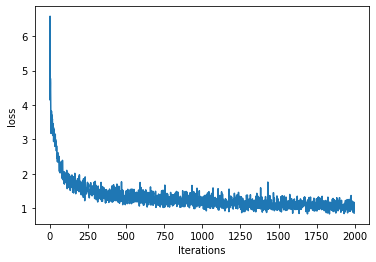

100%|██████████| 2000/2000 [01:24<00:00, 23.69it/s]


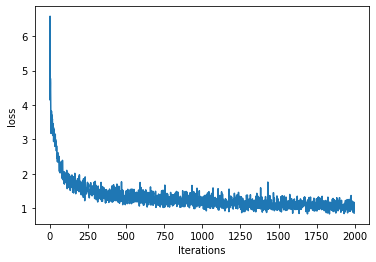

In [32]:
# Define the optimizer and training operation

# instantiate a new model
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

# instantiate an optimizer with its learning rate
optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x,y):
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    # feed the current input into the model and generate predictions
    y_hat = model(x)

    # compute the loss
    loss = compute_loss(y, y_hat)

    # compute the gradients
    '''
    Remember that we want the gradient of the loss with respect all 
    of the model parameters. 
    HINT: use `model.trainable_variables` to get a list of all model
    parameters.'''
    grads = tape.gradient(loss, model.trainable_variables)

    # apply the gradients to the optimizer so that it can update the model accordingly
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    return loss

################
#Begin Training#
################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2,xlabel='Iterations',ylabel='loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):
  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch,y_batch)

  # update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # update the model with the changed weights
  if iter%100 == 0:
    model.save_weights(checkpoint_prefix)

# save the trained model and the weights
model.save_weights(checkpoint_prefix)

# Generate Music Using the RNN Model

Now, we can use our trained RNN model to generate some music! When generating music, we'll have to feed the model some sort of seed to get it started (because it can't predict anything without something to start with!).

Once we have a generated seed, we can then iteratively predict each successive character (remember, we are using the ABC representation for our music) using our trained RNN. More specifically, recall that our RNN outputs a softmax over possible successive characters. For inference, we iteratively sample from these distributions, and then use our samples to encode a generated song in the ABC format.

Then, all we have to do is write it to a file and listen!




### Restore the latest checkpoint
To keep this inference step simple, we will use a batch size of 1. Because of how the RNN state is passed from timestep to timestep, the model will only be able to accept a fixed batch size once it is built.

To run the model with a different batch_size, we'll need to rebuild the model and restore the weights from the latest checkpoint, i.e., the weights after the last checkpoint during training:



In [33]:
# Rebuild a model using batch_size of 1
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoints after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1,None]))

model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_2 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_2 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_2 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


# The Prediction Procedure
Now, we're ready to write the code to generate text in the ABC music format:

- Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

- Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

- Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

- At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.

![Screenshot 2020-09-23 at 18 29 01](https://user-images.githubusercontent.com/26361028/94015554-a7e14180-fdca-11ea-881b-53040aa7c9b4.png)


In [38]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  '''TODO: convert the start string to numbers (vectorize)'''
  input_eval = [char2idx[s] for s in start_string] # TODO
  # input_eval = ['''TODO''']
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      '''TODO: use a multinomial distribution to sample'''
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      
      '''TODO: add the predicted character to the generated text!'''
      text_generated.append(idx2char[predicted_id]) # TODO 
    
  return (start_string + ''.join(text_generated))

In [39]:
'''TODO: Use the model and the function defined above to generate ABC format text of length 1000!
    As you may notice, ABC files start with "X" - this may be a good start string.'''
generated_text = generate_text(model, start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:04<00:00, 219.83it/s]


In [40]:
generated_text

'X:18\nT:Travel\nZ: id:dc-jig-65\nM:6/8\nL:1/8\nK:G Dorian\nAG|FADd FAD|FGA Bcd|ecA GED|!\nDFD D2g|fab|ab^g gbe|fed B2c|!\nFAA A2B|AFE ABc|Bcd e2d|cAG F2:|!\n\nX:1\nT:Barkey Trela\nZ: id:dc-hornpipe-31\nM:C|\nL:1/8\nK:D Major\nAG|FDFA BAGF|E2GA Bdgf|eAA2 e2fe|d3A B3G|EGG2 D2:|!\nD|DGGB d2nsladdy Marfy\nZ: id:dc-jig-7\nM:6/8\nL:1/8\nK:D Major\nDG|abag fdd2|dgga gter\nZ: id:dc-jig-131\nM:6/8\nL:1/8\nK:D Mixolydian\nzBA B3|f2d f3|gee dBG|Bdd de:|!\n\nX:132\nT:Lary Reke\nZ: id:dc-reer-319\nM:C\nL:1/8\nK:G Major\nA|dfed Bcbg|a3g f3g|agfa gebe|afef dfaf|!\neAA2 BAFA|BAFB ABcB|AFED FDEF|G2GF G2:|!\nB^g|f2fb|a2fd edB2|FAA2 Bcde|fdcd efdB|AFFA G2:|!\n\nX:14\nT:Hammill the Blarn\nA|BGG2 AGG2|edd^c d^cAG|A2GA AddA|cBAF G24:|!\nA|F2AF BAFA|dfea bagf|e2cB ABcA|AdcB ABdf|edBc AFF2|G2GF D2:|!\nt Breon\nZ: id:dc-reel-65\nM:C\nL:1/8\nK:D Major\nFG|AFF2 BEE2|E2AF G2BG|DGBd edBG|A2d2 A2FA|BAGB d2:|!\nBc|d2Bd edBd|egg2 fdg2|fgag fdd2|egg2 efge|dBAB G2:|!\ne|fddB ceed|feaf efde|fceg fed2|d2Bd efgf|!\nedef 

# Playback the generated music

We can now call a function to convert the ABC format text to an audio file, and then play that back to check out our generated music! Try training longer if the resulting song is not long enough, or re-generating the song!

In [41]:
### Play back generated songs ###

generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Found 2 songs in text
Generated song 0


Generated song 1
